In [1]:
import os
import pickle

from natsort import natsorted

import anndata as ad
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from scipy.stats import mannwhitneyu
from statsmodels.stats.multitest import multipletests

%matplotlib inline
import plotnine
from plotnine import *

from cell2location.utils import select_slide
from cell2location.plt import plot_spatial
from cell2location.models import RegressionModel, Cell2location
import scvi

import sys
sys.path.insert(0, "..")
from plot_settings import *
from spatial_correlation import FullRandomEffectsModel

Global seed set to 0


In [2]:
results_folder = "cell2location_results"
ref_run_name = os.path.join(results_folder, "reference_signatures")
run_name = os.path.join(results_folder, "cell2location_map")

In [3]:
adata_ref = ad.read_h5ad("../../adata_nuclei_Celltype_subclustered.h5ad").raw.to_adata()
adata_ref.X.data = np.exp(adata_ref.X.data) - 1
adata_ref.X = adata_ref.X.multiply(
    adata_ref.obs.total_counts.to_numpy()[:, np.newaxis]
).tocsr()
adata_ref.X.data = np.round(adata_ref.X.data / 1e4)

/home/kats/.local/lib/python3.10/site-packages/pandas/core/arraylike.py:405: RuntimeWarning: divide by zero encountered in log10


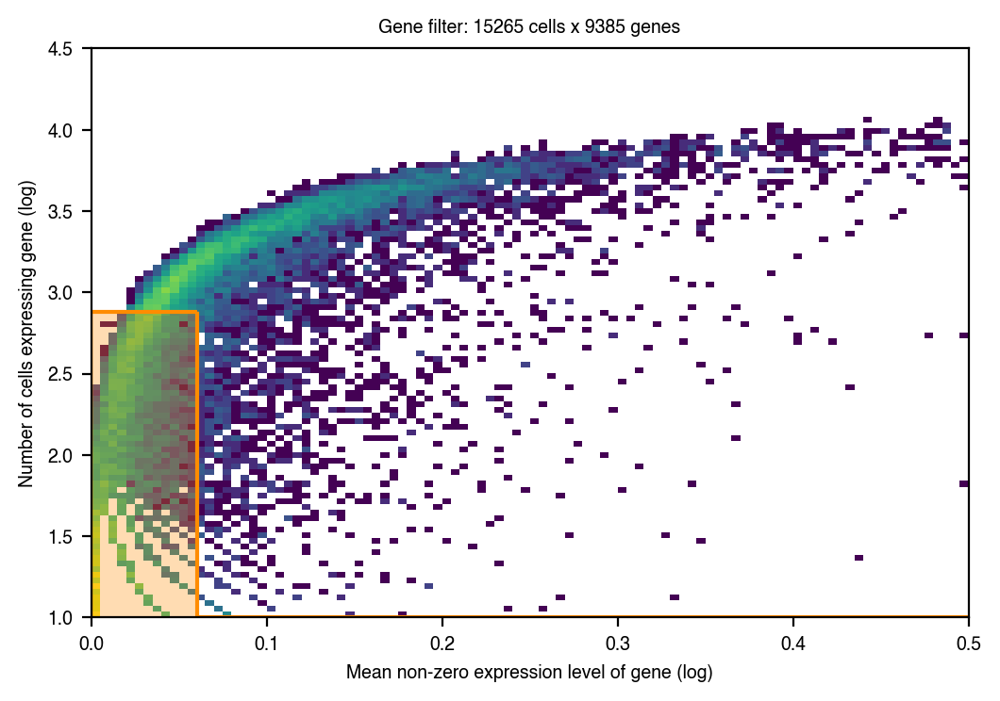

In [4]:
from cell2location.utils.filtering import filter_genes

with mpl.rc_context({"figure.dpi": 200}):
    selected = filter_genes(
        adata_ref, cell_count_cutoff=10, cell_percentage_cutoff2=0.05, nonz_mean_cutoff=1.15
    )

# filter the object
adata_ref = adata_ref[:, selected].copy()

In [5]:
RegressionModel.setup_anndata(
    adata=adata_ref, batch_key="batch", labels_key="Cell_types"
)
mod = RegressionModel(adata_ref)
mod.view_anndata_setup(adata_ref)

Anndata setup with scvi-tools version 0.16.2.

Setup via `RegressionModel.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'batch',
│   'labels_key': 'Cell_types',
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_cells          │ 15265 │
│          n_vars          │ 9385  │
│         n_batch          │   3   │
│         n_labels         │  12   │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │          adata.X          │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
│    ind_x     │   adata.obs['_indices']   │
└──────────────┴───────────────────────────┘

                  batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃  Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['batch'] │     0      │          0          │
│                    │     1      │          1          │
│                    │     2      │          2          │
└────────────────────┴────────────┴─────────────────────┘

                                labels State Registry                                
┏━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃     Source Location     ┃            Categories             ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['Cell_types'] │      Anti-Tumor Macrophages       │          0          │
│                         │            Astrocytes             │          1          │
│                         │         Endothelial Cells         │          2          │
│                         │            Macrophages            │          3          │
│                         │         Malignant Cycling         │          4          │
│                         │ Malignant Neuronal Development I  │          5          │
│                         │ Malignant Neuronal Development II │          6          │
│                         │          Malignant SHH I          │          7          │
│                         │         Malignant SHH II          │          8          │
│                         │           Meninge Cells           │          9          │
│                         │       Pro-Tumor Macrophages       │         10          │
│                         │          Purkinje Cells           │         11          │
└─────────────────────────┴───────────────────────────────────┴─────────────────────┘

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/configuration_validator.py:120: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (7) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Epoch 1/500:   0%|                                                                                                                                                                | 0/500 [00:00<?, ?it/s]

/home/kats/.local/lib/python3.10/site-packages/torch/distributions/gamma.py:71: UserWarning: Specified kernel cache directory could not be created! This disables kernel caching. Specified directory is /home/kats/.cache/torch/kernels. This warning will appear only once per process. (Triggered internally at  ../aten/src/ATen/native/cuda/jit_utils.cpp:860.)
  self.rate * value - torch.lgamma(self.concentration))


Epoch 500/500: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [05:11<00:00,  1.61it/s, v_num=1, elbo_train=6.67e+7]


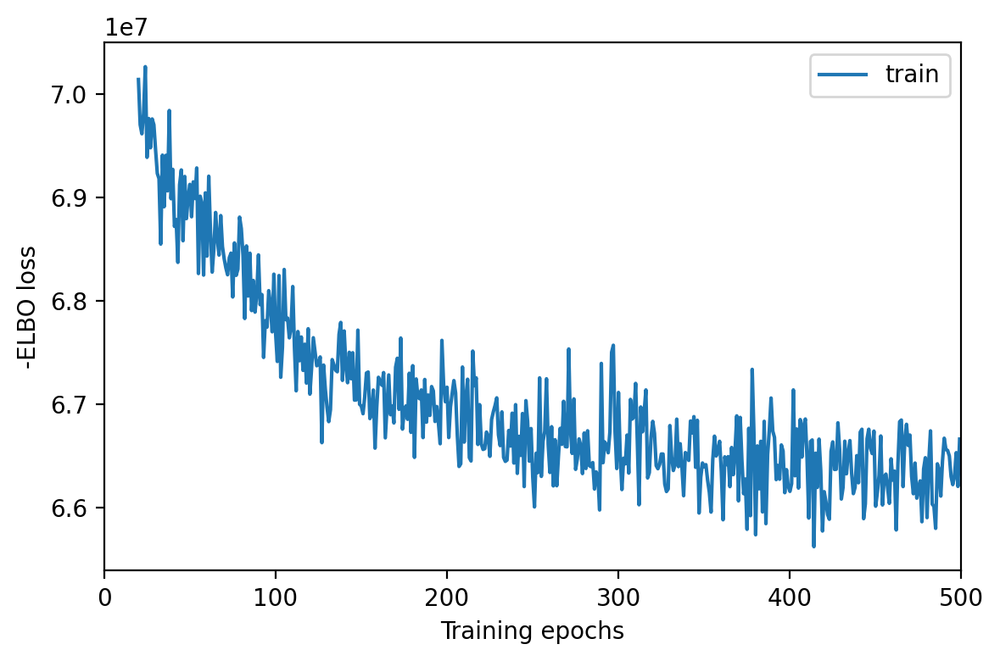

In [7]:
mod.train(max_epochs=500, batch_size=2500, train_size=1, lr=0.001, use_gpu=True)
with mpl.rc_context({"figure.dpi": 200}):
    mod.plot_history(20)

In [8]:
mod.save(ref_run_name, overwrite=True)

In [9]:
adata_ref = mod.export_posterior(
    adata_ref, sample_kwargs={"num_samples": 10000, "batch_size": 2500, "use_gpu": True}
)
adata_ref.write(
    os.path.join(ref_run_name, "sc.h5ad"), compression="gzip", compression_opts=9
)

Sampling global variables, sample: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 9999/9999 [01:16<00:00, 130.33it/s]


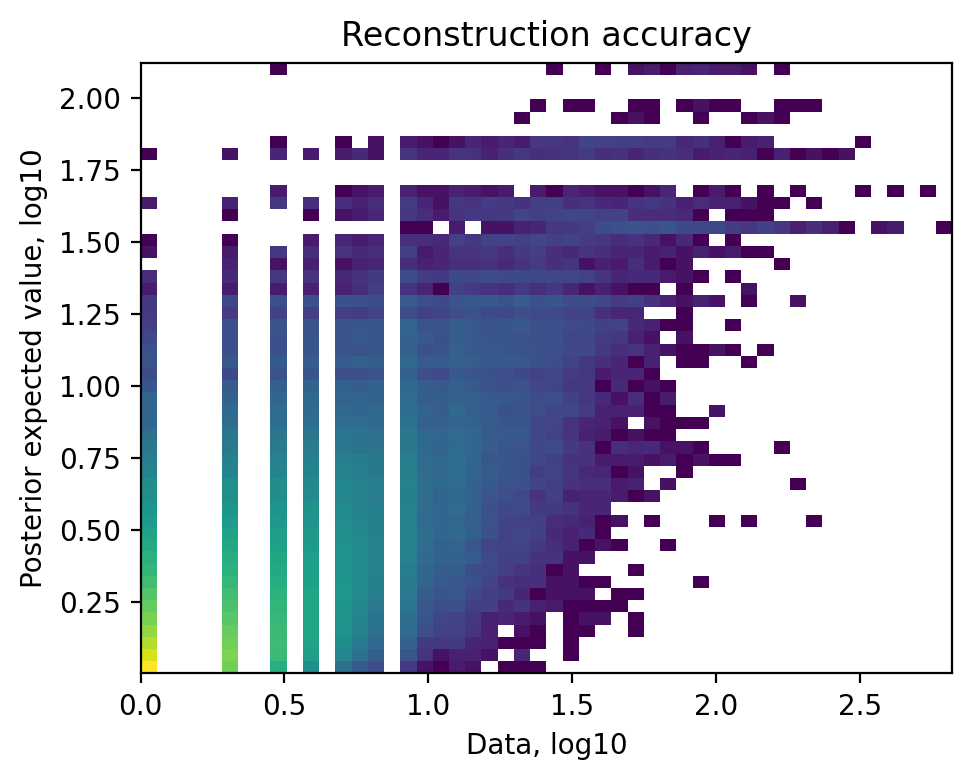

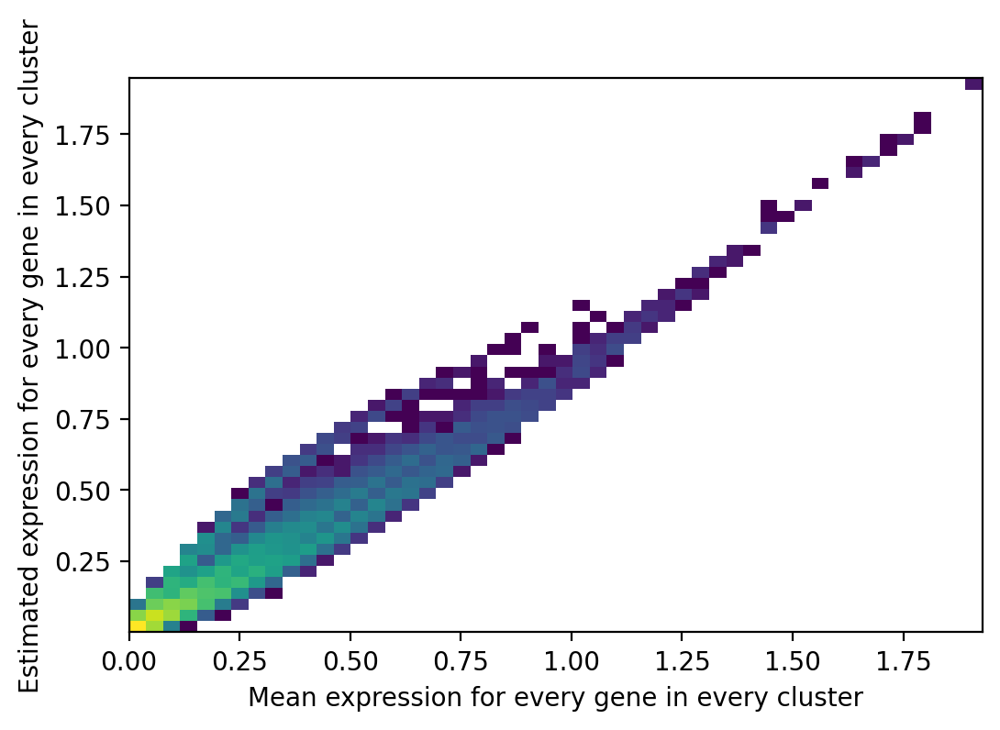

In [10]:
with mpl.rc_context({"figure.dpi": 200}):
    mod.plot_QC()

In [108]:
adata_ref = sc.read_h5ad(os.path.join(ref_run_name, "sc.h5ad"))

In [109]:
adatas = {}
for f in os.scandir("adatas/"):
    adatas[os.path.splitext(f.name)[0]] = ad.read_h5ad(f.path)

In [110]:
adata_vis = ad.concat(
    adatas, label="sample", merge="same", uns_merge="unique", index_unique="_"
)

In [111]:
inf_aver = adata_ref.varm["means_per_cluster_mu_fg"][
    [f"means_per_cluster_mu_fg_{i}" for i in adata_ref.uns["mod"]["factor_names"]]
]
inf_aver.columns = adata_ref.uns["mod"]["factor_names"]

intersect = adata_ref.var_names.intersection(adata_vis.var_names)

adata_vis = adata_vis[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :]

Cell2location.setup_anndata(adata_vis, batch_key="sample", layer="counts")
mod = Cell2location(
    adata_vis, cell_state_df=inf_aver, N_cells_per_location=30, detection_alpha=200
)
mod.view_anndata_setup(adata_vis)

Anndata setup with scvi-tools version 0.16.2.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': 'counts',
│   'batch_key': 'sample',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_cells          │ 25992 │
│          n_vars          │ 5778  │
│         n_batch          │  13   │
│         n_labels         │   1   │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │  adata.layers['counts']   │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
│    ind_x     │   adata.obs['_indices']   │
└──────────────┴───────────────────────────┘

                   batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['sample'] │    1.2     │          0          │
│                     │    2.2     │          1          │
│                     │    1.1     │          2          │
│                     │    4.1     │          3          │
│                     │    2.1     │          4          │
│                     │    5.4     │          5          │
│                     │    5.2     │          6          │
│                     │    3.4     │          7          │
│                     │    3.1     │          8          │
│                     │    1.3     │          9          │
│                     │    4.3     │         10          │
│                     │    2.4     │         11          │
│                     │    5.3     │         12          │
└─────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

In [14]:
mod.train(max_epochs=30000, batch_size=None, train_size=1, use_gpu=True)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/configuration_validator.py:120: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Epoch 30000/30000: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 30000/30000 [1:44:37<00:00,  4.78it/s, v_num=1, elbo_train=2.25e+8]


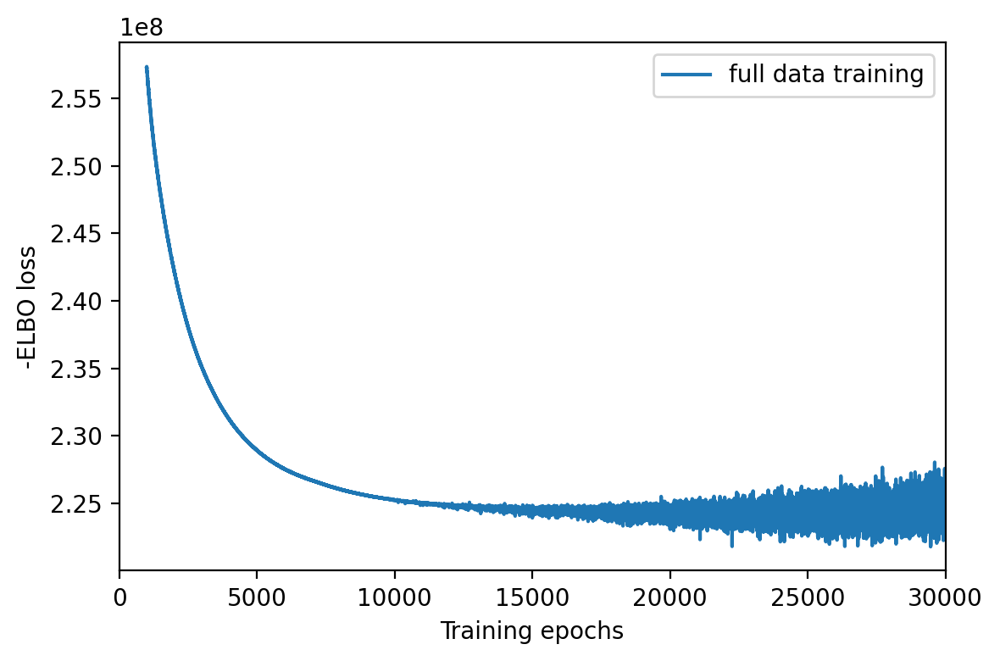

In [15]:
with mpl.rc_context({"figure.dpi": 200}):
    mod.plot_history(1000)
    plt.legend(labels=["full data training"])

In [16]:
mod.save(run_name, overwrite=True)

In [4]:
mod = Cell2location.load(run_name, adata_vis)

INFO     File cell2location_results/cell2location_map/model.pt already downloaded            
INFO     Preparing underlying module for load                                                


GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/configuration_validator.py:120: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/home/kats/.local/lib/python3.10/site-packages/pytorch_lightning/trainer/data_loading.py:432: UserWarning: The number of training samples (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Epoch 1/30000:   0%|                                                                                                                     | 1/30000 [00:00<6:01:14,  1.38it/s, v_num=1, elbo_train=4.87e+8]


In [ ]:
adata_vis = mod.export_posterior(
    adata_vis,
    sample_kwargs={"num_samples": 5000, "batch_size": mod.adata.n_obs, "use_gpu": True},
)
adata_vis.write(
    os.path.join(run_name, "sp.h5ad"), compression="gzip", compression_opts=9
)

In [ ]:
mod.plot_QC()

In [3]:
adata_vis = ad.read_h5ad(os.path.join(run_name, "sp.h5ad"))

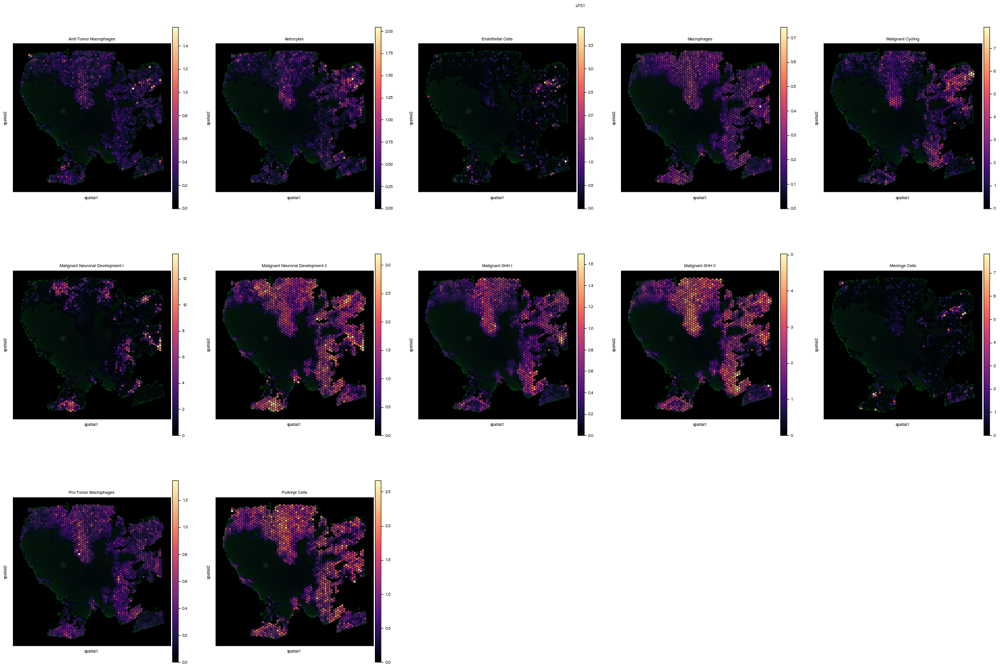

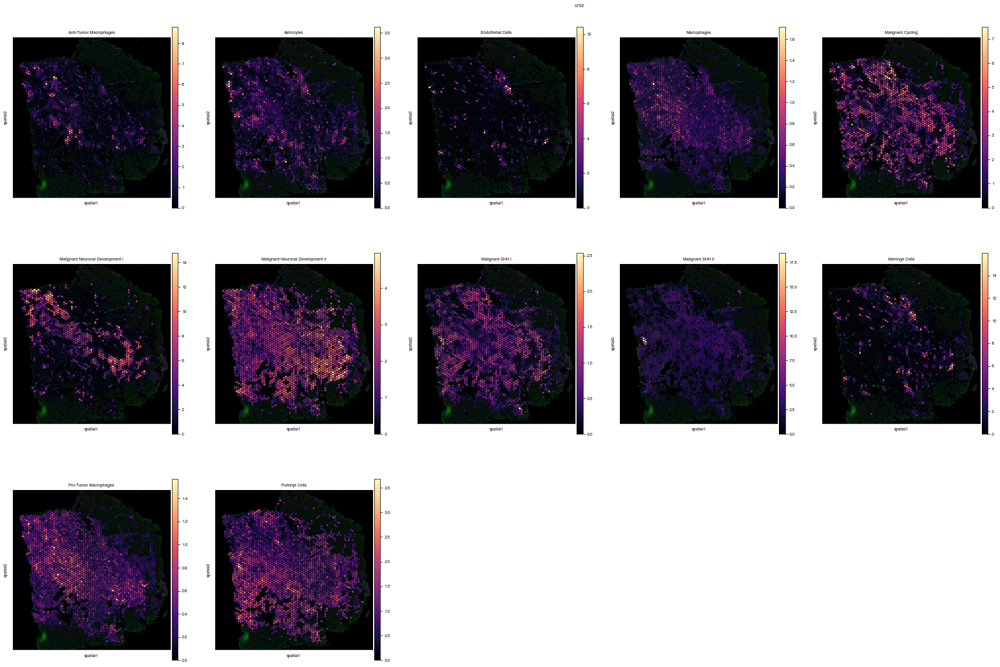

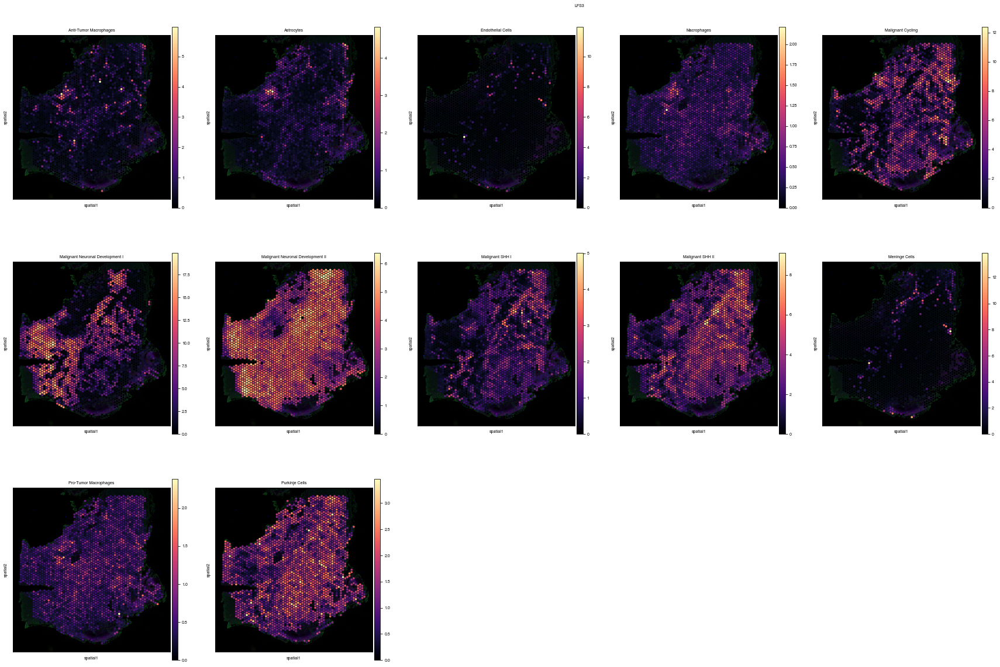

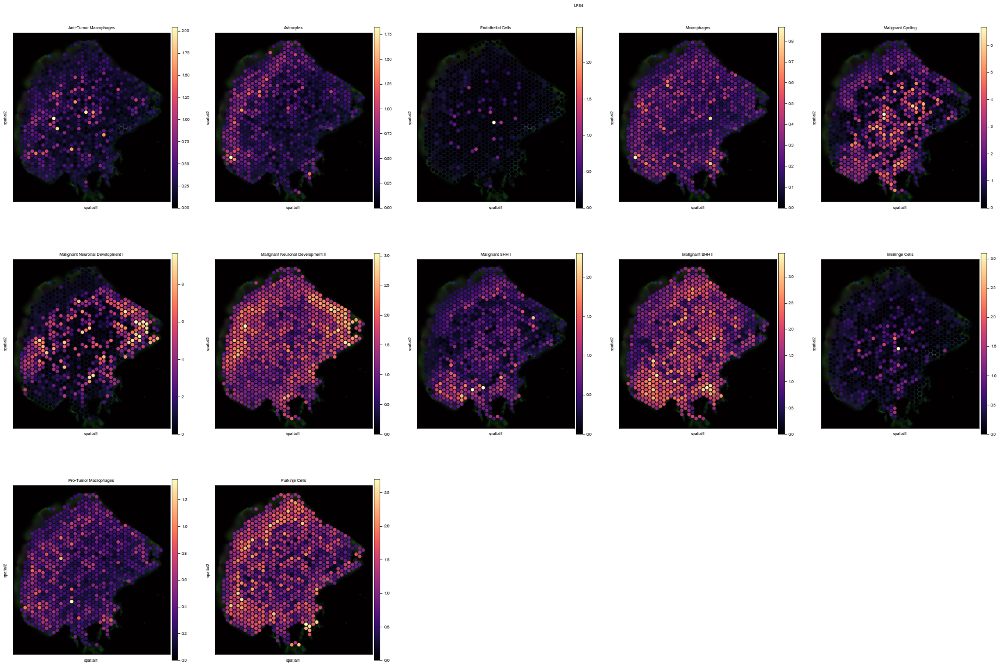

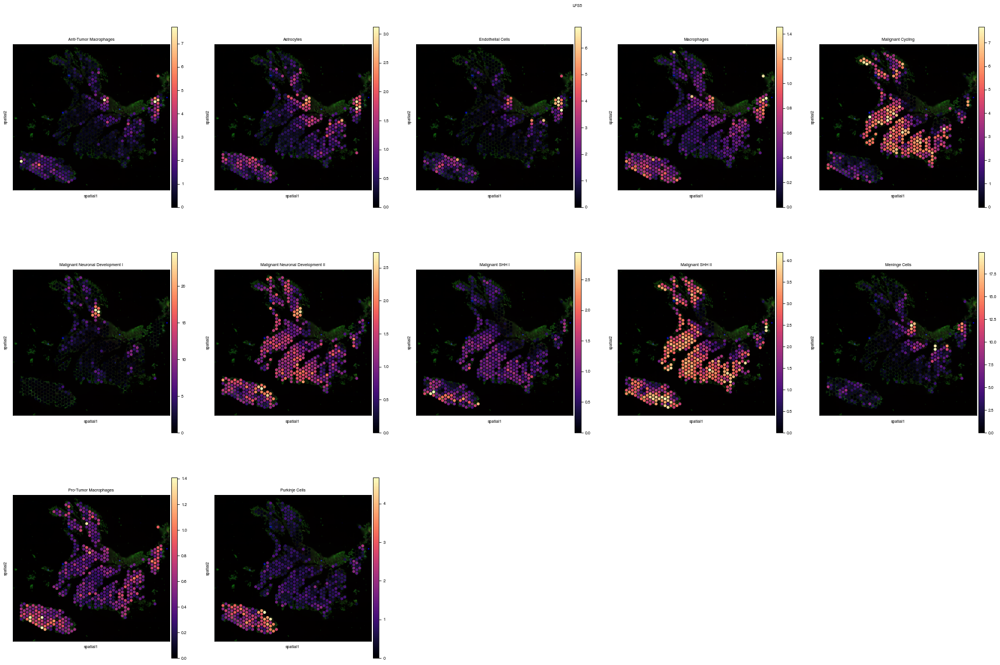

...

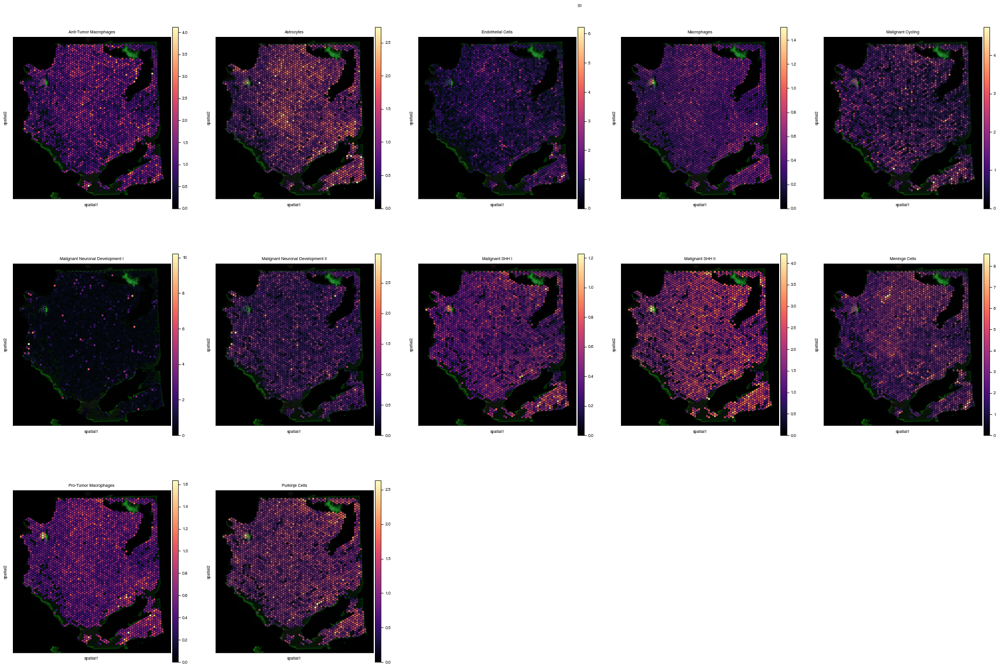

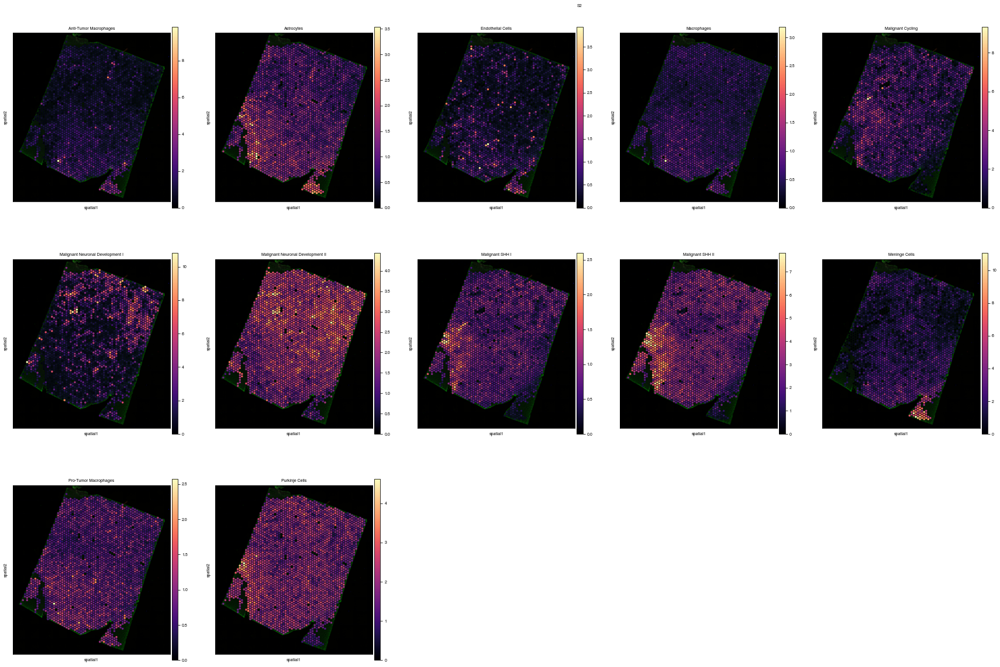

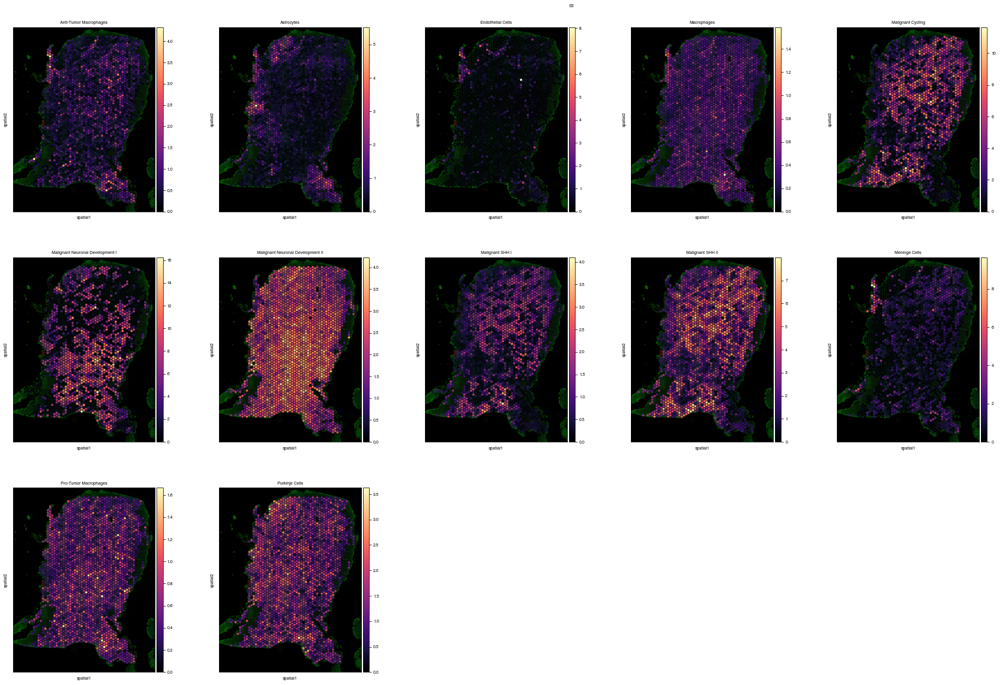

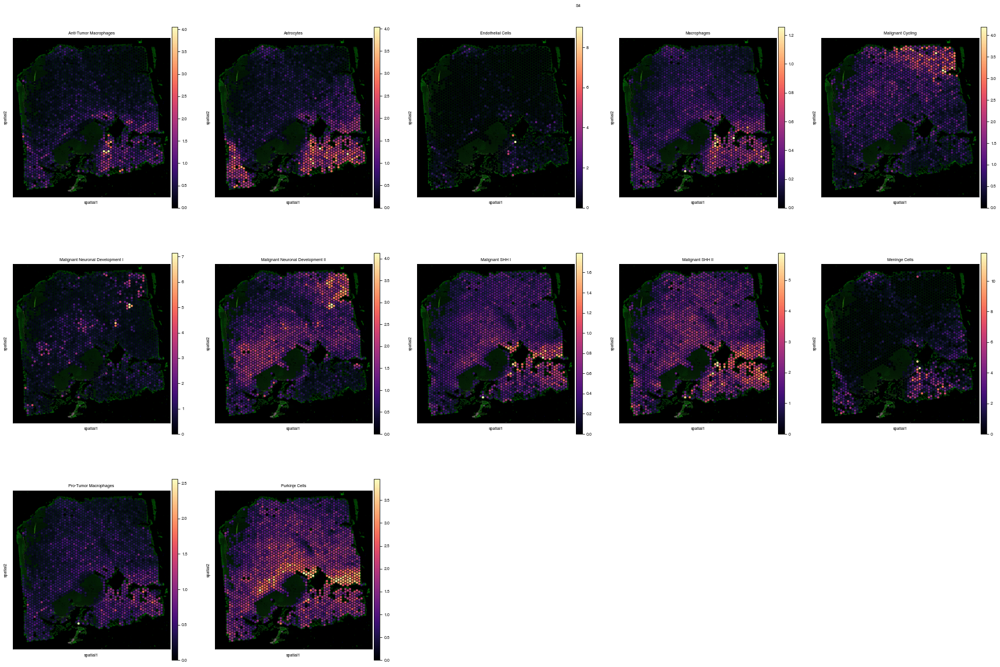

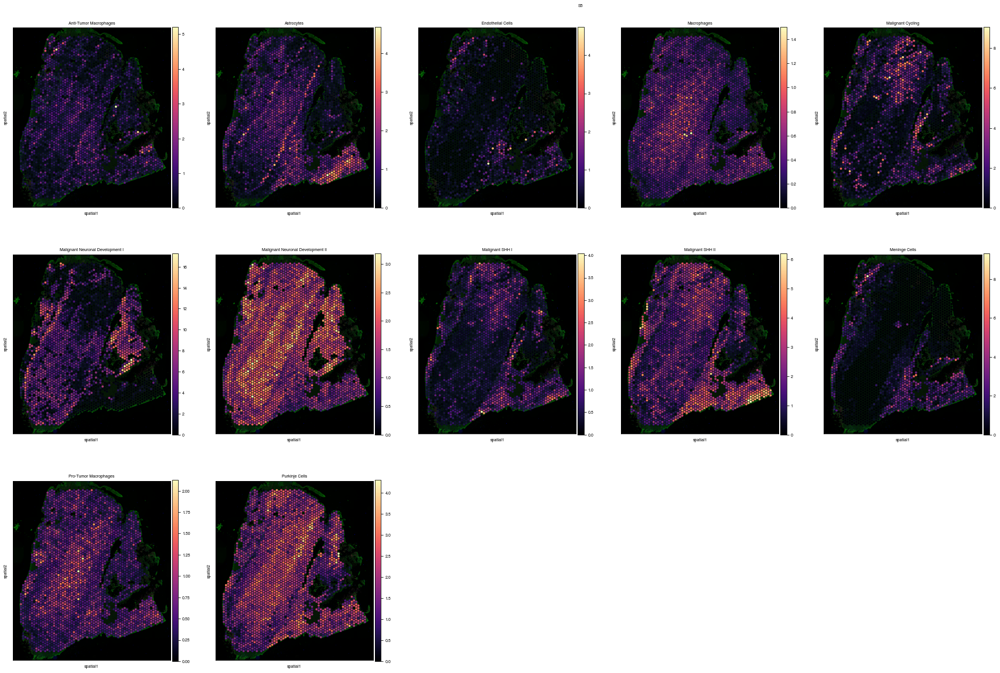

In [5]:
adata_vis.obs[adata_vis.uns["mod"]["factor_names"]] = adata_vis.obsm[
    "q05_cell_abundance_w_sf"
]
with mpl.rc_context({"figure.figsize": (5, 6)}):
    for sample in sorted(adata_vis.uns["spatial"].keys()):
        slide = select_slide(adata_vis, sample)
        sc.pl.spatial(
            slide,
            cmap="magma",
            color=adata_vis.uns["mod"]["factor_names"],
            ncols=5,
            size=1.3,
            vmin=0,
            show=False,
        )
        plt.gcf().suptitle(human_sample_map[sample], y=0.91)

In [6]:
adata_vis.obs[adata_vis.uns["mod"]["factor_names"]] = adata_vis.obsm[
    "q05_cell_abundance_w_sf"
].div(adata_vis.obsm["q05_cell_abundance_w_sf"].sum(1), axis=0)

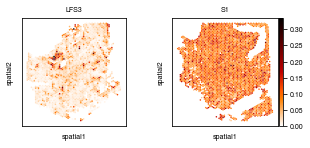

In [7]:
with mpl.rc_context({"figure.figsize": (5, 2)}):
    slides = select_slide(adata_vis, "1.3"), select_slide(adata_vis, "4.1")
    fig, ax = plt.subplots(1, 2)
    vmax = np.max([slide.obs["Anti-Tumor Macrophages"].max() for slide in slides])
    for i, (title, slide) in enumerate(zip(("1.3", "4.1"), slides)):
        cbarloc = "right" if i == len(slides) - 1 else None
        sc.pl.spatial(
            slide,
            cmap=mpl.cm.get_cmap("gist_heat").reversed(),
            img_key=None,
            size=1.5,
            color="Anti-Tumor Macrophages",
            vmin=0,
            vmax=vmax,
            ax=ax[i],
            colorbar_loc=cbarloc,
            title=human_sample_map[title],
            show=False
        )
    
    fig.savefig("figures/2A.svgz")
    plt.show()

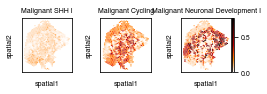

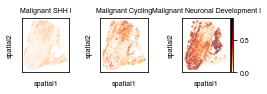

In [8]:
with mpl.rc_context({"figure.figsize": (4, 1)}):
    for sample in ("2.1", "5.4"):
        slide = select_slide(adata_vis, sample)
        fig, ax = plt.subplots(1, 3)
        celltypes = ["Malignant SHH I", "Malignant Cycling", "Malignant Neuronal Development I"]
        vmax = slide.obs[celltypes].max().max()
        for i, ct in enumerate(celltypes):
            cbarloc = "right" if i == len(celltypes) - 1 else None
            sc.pl.spatial(
                slide,
                cmap=mpl.cm.get_cmap("gist_heat").reversed(),
                img_key=None,
                size=1.5,
                color=ct,
                vmin=0,
                vmax=vmax,
                ax=ax[i],
                colorbar_loc=cbarloc,
                title=ct,
                show=False
            )
        plt.savefig(f"figures/BC_{sample}.svgz")
        plt.show()

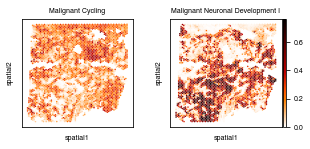

In [9]:
with mpl.rc_context({"figure.figsize": (5, 2)}):
    slide = select_slide(adata_vis, "3.4")
    fig, ax = plt.subplots(1, 2)
    celltypes = ["Malignant Cycling", "Malignant Neuronal Development I"]
    vmax = slide.obs[celltypes].max().max()
    for i, ct in enumerate(celltypes):
        cbarloc = "right" if i == len(celltypes) - 1 else None
        sc.pl.spatial(
            slide,
            cmap=mpl.cm.get_cmap("gist_heat").reversed(),
            img_key=None,
            size=1.5,
            color=ct,
            vmin=0,
            vmax=vmax,
            ax=ax[i],
            colorbar_loc=cbarloc,
            title=ct,
            show=False
        )
    plt.savefig(f"figures/4F.svgz")
    plt.show()

In [10]:
adatas = {}
for f in os.scandir("adatas/"):
    adatas[os.path.splitext(f.name)[0]] = ad.read_h5ad(f.path)

In [11]:
celltypeorder = [
    "Macrophages",
    "Anti-Tumor Macrophages",
    "Pro-Tumor Macrophages",
    "Astrocytes",
    "Endothelial Cells",
    "Meninge Cells",
    "Purkinje Cells",
    "Malignant Cycling",
    "Malignant Neuronal Development I",
    "Malignant Neuronal Development II",
    "Malignant SHH I",
    "Malignant SHH II",
]
celltypecolors = [
    "#f3e442",
    "#d55e00",
    "#56b4e9",
    "#e31a1c",
    "#fb9a99",
    "#33a02c",
    "#1f78b4",
    "#cab2d6",
    "#009e73",
    "#5a14a5",
    "#c8c8c8",
    "#323232",
]

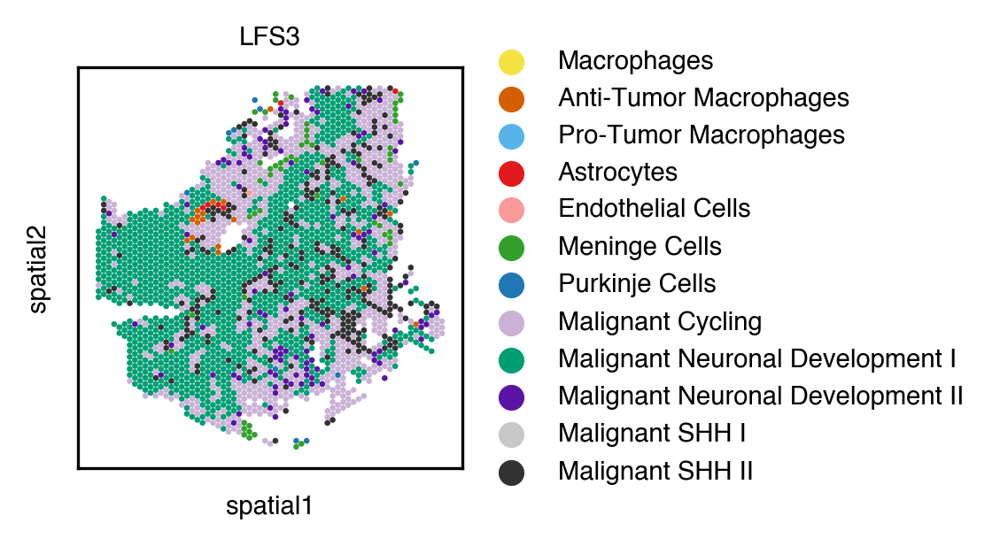

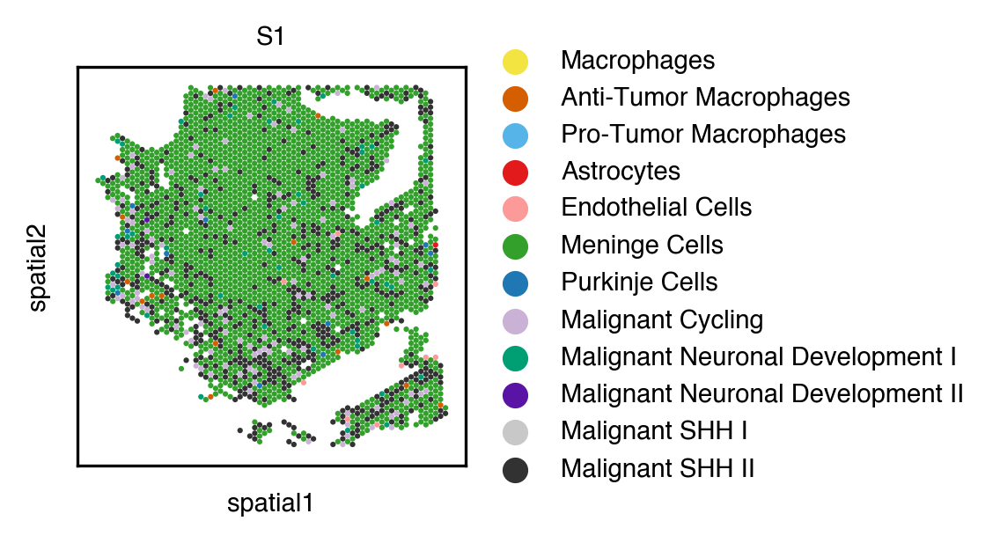

In [12]:
with mpl.rc_context({"figure.figsize": (4, 2), "figure.dpi": 300}):
    for sample in ("1.3", "4.1"):
        adata = select_slide(adata_vis, sample)

        adata.obs["dominant_celltype"] = pd.Categorical(
            adata.obsm["q05_cell_abundance_w_sf"]
            .rename(columns=lambda x: x[23:])
            .idxmax(axis=1),
            categories=celltypeorder,
        )
        sc.pl.spatial(
            adata,
            color="dominant_celltype",
            title=human_sample_map[sample],
            palette=celltypecolors,
            img_key=None,
            size=1.5,
            show=False
        )
        plt.savefig(f"figures/1B_dominant_celltype_{sample}.svgz")
        plt.show()

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_1.1.svgz


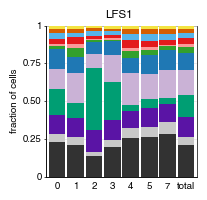

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_1.2.svgz


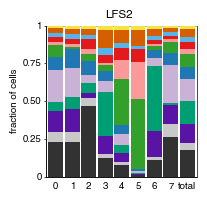

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_1.3.svgz


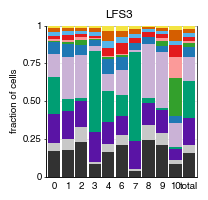

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_2.1.svgz


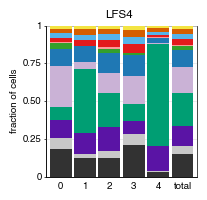

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_2.2.svgz


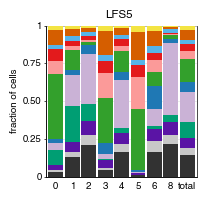

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_2.4.svgz


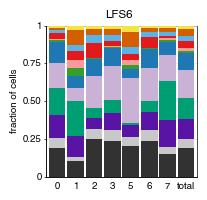

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_3.1.svgz


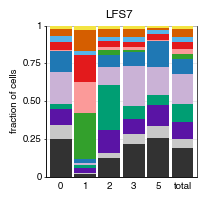

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_3.4.svgz


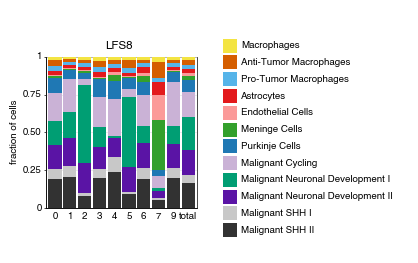

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_4.1.svgz


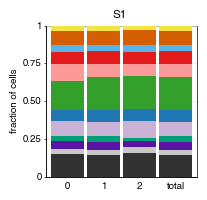

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_4.3.svgz


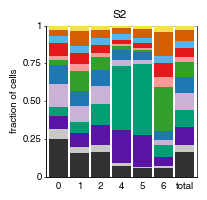

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_5.2.svgz


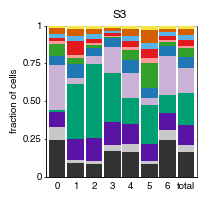

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_5.3.svgz


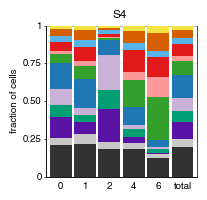

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S6_5.4.svgz


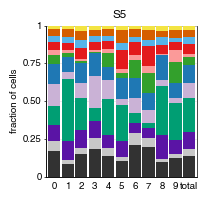

In [13]:
dfs = {}
for sample in sorted(adata_vis.uns["spatial"].keys()):
    slide = select_slide(adata_vis, sample)
    df = slide.obsm["q05_cell_abundance_w_sf"].rename(
        index=lambda x: x[:-4], columns=lambda x: x[23:]
    )

    adata = adatas[sample]
    clabels = adata.obs.segmentation_labels.value_counts().loc[lambda x: x > 1].index
    adata = adata[adata.obs.segmentation_labels.isin(clabels), :]

    df = df.loc[adata.obs_names, :]
    df["segmentation_labels"] = adata.obs.segmentation_labels
    df = (
        df.melt(
            id_vars="segmentation_labels",
            var_name="celltype",
            value_name="abundance",
        )
        .groupby(["segmentation_labels", "celltype"])
        .sum()
    )

    df = (
        pd.concat(
            (
                df.reset_index().assign(
                    segmentation_labels=lambda x: x.segmentation_labels.astype(str)
                ),
                df.groupby("celltype")
                .sum()
                .reset_index()
                .assign(segmentation_labels="total"),
            ),
            axis=0,
        )
        .assign(
            segmentation_labels=lambda x: pd.Categorical(
                x.segmentation_labels,
                categories=natsorted(x.segmentation_labels.unique()),
            )
        )
        .reset_index(drop=True)
    )

    df["celltype_fraction"] = df.groupby("segmentation_labels")["abundance"].transform(
        lambda x: x / x.sum()
    )
    df = df.assign(
        celltype=lambda x: pd.Categorical(x.celltype, categories=celltypeorder)
    )

    dfs[sample] = df
    p = (
        ggplot(
            df,
            aes("segmentation_labels", "celltype_fraction", fill="celltype"),
        )
        + geom_bar(stat="identity")
        + scale_y_continuous(expand=(0, 0))
        + scale_fill_manual(
            values=celltypecolors,
            breaks=celltypeorder,
        )
        + labs(title=human_sample_map[sample], x=None, y="fraction of cells", fill="")
        + theme(figure_size=(1.95, 1.95), axis_ticks_major_x=element_blank())
    )
    if sample != "3.4":
        p += guides(fill=None)
    p.save(f"figures/S6_{sample}.svgz")
    print(p)

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/1B_celltype_fractions_1.3.svgz


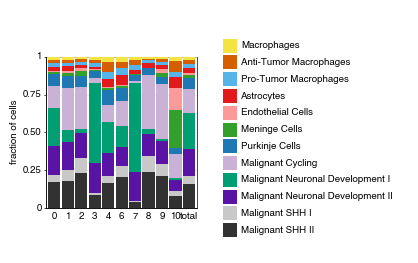

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 1.95 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/1B_celltype_fractions_4.1.svgz


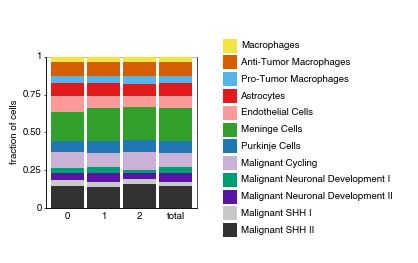

In [14]:
for sample in ("1.3", "4.1"):
    p = (
        ggplot(
            dfs[sample],
            aes("segmentation_labels", "celltype_fraction", fill="celltype"),
        )
        + geom_bar(stat="identity")
        + scale_y_continuous(expand=(0, 0))
        + scale_fill_manual(
            values=celltypecolors,
            breaks=celltypeorder,
        )
        + labs(x=None, y="fraction of cells", fill="")
        + theme(figure_size=(1.95, 1.95), axis_ticks_major_x=element_blank())
    )
    p.save(f"figures/1B_celltype_fractions_{sample}.svgz")
    print(p)

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 3 x 3 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/1C_celltype_fractions.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

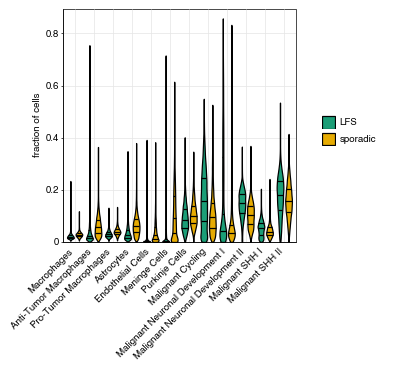

In [15]:
df = adata_vis.obsm["q05_cell_abundance_w_sf"].rename(columns=lambda x: x[23:])
df = df.div(df.sum(axis=1), axis=0)
df = pd.concat((adata_vis.obs["sample"], df), axis=1)
df = (
    df.melt(id_vars="sample", var_name="celltype", value_name="fraction", ignore_index=False)
    .reset_index(names="spot")
    .assign(
        type="LFS",
        sample=lambda x: pd.Categorical(
            x["sample"], categories=np.sort(x["sample"].unique())
        ),
        celltype=lambda x: pd.Categorical(x.celltype, categories=celltypeorder),
        spot=lambda x: x.spot.str[:-4]
    )
    .assign(sample=lambda x: x["sample"].cat.rename_categories(human_sample_map))
)
df.loc[df["sample"].str[0] == "S", "type"] = "sporadic"
p = (
    ggplot(
        df, aes("celltype", "fraction", fill="type", group="celltype.astype(str)+type")
    )
    + geom_violin(
        scale="width",
        color="black",
        n=4096,
        width=0.7,
        position=position_dodge(width=0.9),
        draw_quantiles=[0.25, 0.5, 0.75],
    )
    + scale_y_continuous(limits=(0, None), expand=(0, 0, 0.04, 0))
    + lfs_sporadic_fill_scale
    + labs(x=None, y="fraction of cells", color="", fill="")
    + guides(color=guide_legend(override_aes={"size": 2, "alpha": 1}))
    + theme(
        axis_text_x=element_text(rotation=45, ha="right"),
        figure_size=(3, 3),
        axis_ticks_major_x=element_blank(),
    )
)
p.save("figures/1C_celltype_fractions.svgz")
print(p)

In [16]:
pd.DataFrame({"pval":df.groupby(["celltype"]).apply(
    lambda x: mannwhitneyu(
        x.fraction[x.type == "LFS"], x.fraction[x.type == "sporadic"]
    ).pvalue
)}).assign(padj=lambda x: multipletests(x.pval, method="fdr_bh")[1])

,pval,padj
celltype,,
Macrophages,0.000000e+00,0.000000e+00
Anti-Tumor Macrophages,0.000000e+00,0.000000e+00
Pro-Tumor Macrophages,0.000000e+00,0.000000e+00
Astrocytes,0.000000e+00,0.000000e+00
Endothelial Cells,0.000000e+00,0.000000e+00
Meninge Cells,0.000000e+00,0.000000e+00
Purkinje Cells,2.254646e-136,2.705575e-136
Malignant Cycling,0.000000e+00,0.000000e+00
Malignant Neuronal Development I,3.478324e-40,3.478324e-40


In [17]:
df.groupby(["sample", "celltype", "type"], observed=True).aggregate(
    np.median
).reset_index().groupby(["celltype"]).apply(
    lambda x: mannwhitneyu(
        x.fraction[x.type == "LFS"], x.fraction[x.type == "sporadic"]
    ).pvalue
).rename(
    "pval"
).reset_index().assign(
    padj=lambda x: multipletests(x.pval, method="fdr_bh")[1]
)

/tmp/ipykernel_45602/4051742643.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.median is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.


,celltype,pval,padj
0,Macrophages,0.045066,0.067599
1,Anti-Tumor Macrophages,0.018648,0.055944
2,Pro-Tumor Macrophages,0.045066,0.067599
3,Astrocytes,0.045066,0.067599
4,Endothelial Cells,0.029526,0.067599
5,Meninge Cells,0.018648,0.055944
6,Purkinje Cells,0.435120,0.474677
7,Malignant Cycling,0.010878,0.055944
8,Malignant Neuronal Development I,0.943279,0.943279
9,Malignant Neuronal Development II,0.170940,0.205128


In [18]:
df.groupby(["celltype", "type"])["fraction"].agg("mean").unstack(level=1).assign(
    foldchange=lambda x: x.sporadic / x.LFS
)

type,LFS,sporadic,foldchange
celltype,,,
Macrophages,0.022283,0.028988,1.300880
Anti-Tumor Macrophages,0.037406,0.062167,1.661958
Pro-Tumor Macrophages,0.031191,0.041310,1.324436
Astrocytes,0.036259,0.066636,1.837749
Endothelial Cells,0.020326,0.038443,1.891262
Meninge Cells,0.042802,0.103140,2.409698
Purkinje Cells,0.092681,0.107918,1.164406
Malignant Cycling,0.165081,0.111380,0.674700
Malignant Neuronal Development I,0.178013,0.131787,0.740322


/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 3 x 3 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/4E_clones_celltypefractions.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

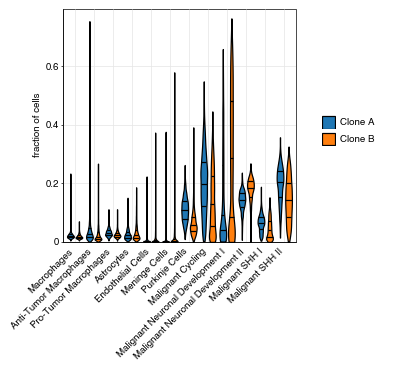

<ggplot: (8733872847458)>

In [19]:
clonedf = df[df["sample"] == human_sample_map["3.4"]].merge(
    adatas["3.4"]
    .obs.segmentation_labels_clonegenes.reset_index()
    .rename(columns={"index": "spot"}),
    on="spot",
)
p = (
    ggplot(
        clonedf,
        aes("celltype", "fraction", fill="segmentation_labels_clonegenes"),
    )
    + geom_violin(
        scale="width",
        color="black",
        n=4096,
        width=0.7,
        position=position_dodge(width=0.9),
        draw_quantiles=[0.25, 0.5, 0.75],
    )
    + scale_y_continuous(limits=(0, None), expand=(0, 0, 0.04, 0))
    + scale_fill_manual(
        values=adatas["3.4"].uns["segmentation_labels_clonegenes_colors"],
        breaks=(0, 1),
        labels=("Clone A", "Clone B"),
    )
    + labs(x=None, y="fraction of cells", fill="")
    + theme(
        axis_text_x=element_text(rotation=45, ha="right"),
        figure_size=(3, 3),
        axis_ticks_major_x=element_blank(),
    )
)
p.save("figures/4E_clones_celltypefractions.svgz")
p

In [20]:
pd.DataFrame(
    {
        "pval": clonedf.groupby("celltype").apply(
            lambda x: mannwhitneyu(
                x.fraction[x.segmentation_labels_clonegenes == 0],
                x.fraction[x.segmentation_labels_clonegenes == 1],
            ).pvalue
        )
    }
).assign(padj=lambda x: multipletests(x.pval, method="fdr_bh")[1])

,pval,padj
celltype,,
Macrophages,2.764524e-45,3.686032e-45
Anti-Tumor Macrophages,1.756974e-47,2.635461e-47
Pro-Tumor Macrophages,1.664224e-75,3.328448e-75
Astrocytes,4.643714e-02,4.643714e-02
Endothelial Cells,8.372288e-03,9.133405e-03
Meninge Cells,5.685332e-11,6.822399e-11
Purkinje Cells,5.048719e-239,6.058462e-238
Malignant Cycling,1.595632e-75,3.328448e-75
Malignant Neuronal Development I,8.177610e-69,1.401876e-68


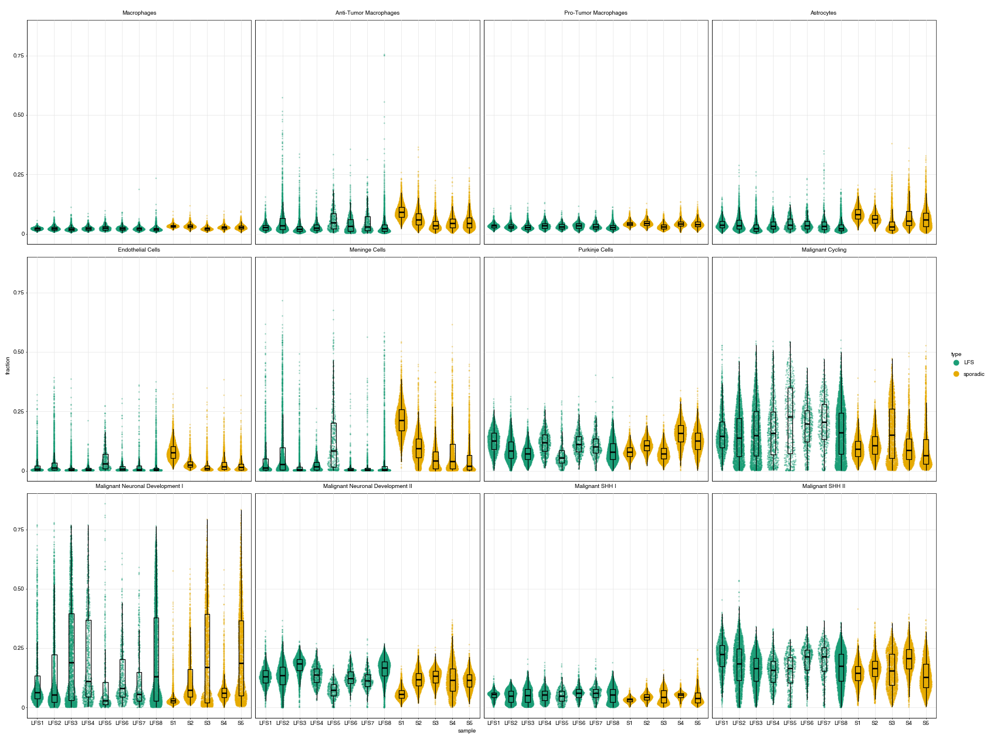

<ggplot: (8733872740671)>

In [21]:
(
    ggplot(df, aes("sample", "fraction", color="type"))
    + geom_sina(
        scale="width",
        alpha=0.3,
        size=0.1,
        maxwidth=0.7,
        position=position_dodge(width=0.9),
    )
    + geom_boxplot(
        width=0.3,
        outlier_shape="",
        position=position_dodge(width=0.9),
        color="black",
        fill=None,
    )
    + facet_wrap("celltype")
    + lfs_sporadic_color_scale
    + guides(color=guide_legend(override_aes={"size": 3, "alpha": 1}))
    + theme(figure_size=(20, 10))
)

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 3 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/2B.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.


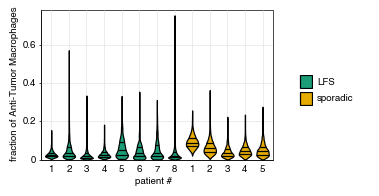

In [22]:
p = (
    ggplot(
        df[df.celltype == "Anti-Tumor Macrophages"],
        aes("sample", "fraction", fill="type"),
    )
    + geom_violin(
        scale="width",
        color="black",
        n=4096,
        width=0.7,
        position=position_dodge(width=0.9),
        draw_quantiles=[0.25, 0.5, 0.75],
    )
    + scale_x_discrete(labels=lambda x: [k[-1] for k in x.keys()])
    + scale_y_continuous(limits=(0, None), expand=(0, 0, 0.04, 0))
    + lfs_sporadic_fill_scale
    + labs(x="patient #", y="fraction of Anti-Tumor Macrophages", color="", fill="")
    + guides(color=guide_legend(override_aes={"size": 2, "alpha": 1}))
    + theme(
        aspect_ratio="auto",
        figure_size=(3, 1.95),
        axis_ticks_major_x=element_blank(),
    )
)
p.save("figures/2B.svgz")
print(p)

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 3 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S7_Pro-Tumor Macrophages.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.


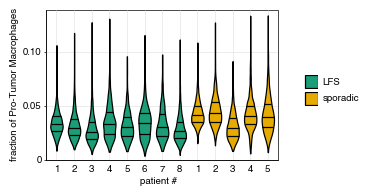

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 3 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S7_Macrophages.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.loca

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

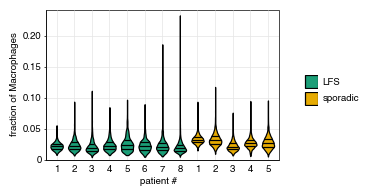

In [23]:
for ct in ("Pro-Tumor Macrophages", "Macrophages"):
    p = (
        ggplot(
            df[df.celltype == ct],
            aes("sample", "fraction", fill="type"),
        )
        + geom_violin(
            scale="width",
            color="black",
            n=4096,
            width=0.7,
            position=position_dodge(width=0.9),
            draw_quantiles=[0.25, 0.5, 0.75],
        )
        + scale_x_discrete(labels=lambda x: [k[-1] for k in x.keys()])
        + scale_y_continuous(limits=(0, None), expand=(0, 0, 0.04, 0))
        + lfs_sporadic_fill_scale
        + labs(x="patient #", y=f"fraction of {ct}", color="", fill="")
        + guides(color=guide_legend(override_aes={"size": 2, "alpha": 1}))
        + theme(
            aspect_ratio="auto",
            figure_size=(3, 1.95),
            axis_ticks_major_x=element_blank(),
        )
    )
    p.save(f"figures/S7_{ct}.svgz")
    print(p)

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 3 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/3E.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

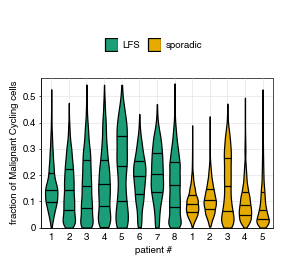

In [24]:
p = (
    ggplot(
        df[df.celltype == "Malignant Cycling"],
        aes("sample", "fraction", fill="type"),
    )
    + geom_violin(
        scale="width",
        color="black",
        n=4096,
        width=0.7,
        position=position_dodge(width=0.9),
        draw_quantiles=[0.25, 0.5, 0.75],
    )
    + scale_x_discrete(labels=lambda x: [k[-1] for k in x.keys()])
    + scale_y_continuous(limits=(0, None), expand=(0, 0, 0.04, 0))
    + lfs_sporadic_fill_scale
    + labs(x="patient #", y="fraction of Malignant Cycling cells", color="", fill="")
    + guides(color=guide_legend(override_aes={"size": 2, "alpha": 1}))
    + theme(
        aspect_ratio="auto",
        figure_size=(3, 1.95),
        axis_ticks_major_x=element_blank(),
        legend_position="top",
    )
)
p.save("figures/3E.svgz")
print(p)

In [25]:
malcyc = df[df.celltype == "Malignant Cycling"].groupby(["sample", "type"], observed=True)[
    "fraction"
].agg(np.median).reset_index(level=0)
mannwhitneyu(malcyc.loc["LFS", "fraction"], malcyc.loc["sporadic", "fraction"])

MannwhitneyuResult(statistic=37.0, pvalue=0.010878010878010878)

In [ ]:
import tensorflow as tf
import gpflow

In [7]:
fake_adatas = {}
for sample in adata_vis.obs["sample"].cat.categories:
    cadata_vis = adata_vis[adata_vis.obs["sample"] == sample]
    cadata = ad.AnnData(
        X=cadata_vis.obsm["q05_cell_abundance_w_sf"].to_numpy(),
        obs=pd.DataFrame(index=cadata_vis.obs_names),
        var=pd.DataFrame(
            index=cadata_vis.obsm["q05_cell_abundance_w_sf"].columns.str[23:]
        ),
        obsm={"spatial": cadata_vis.obsm["spatial"]},
        uns={"spatial": {sample: cadata_vis.uns["spatial"][sample]}},
        dtype=np.float64,
    )
    sc.pp.log1p(cadata)
    sc.pp.scale(cadata)
    fake_adatas[sample] = cadata

In [8]:
from scipy.spatial.distance import pdist, squareform

l_min = squareform(pdist(fake_adatas["1.1"].obsm["spatial"]))
np.fill_diagonal(l_min, np.inf)
l_min = l_min.min()

In [9]:
l_min

307.0

In [94]:
from collections import namedtuple

Result = namedtuple("Result", ("celltype1", "celltype2", "correlation", "lengthscale"))

In [ ]:
from tqdm.auto import tqdm
opt = gpflow.optimizers.Scipy()
results = {}
for sname, cadata in tqdm(fake_adatas.items()):
    cresults = []
    for i, ct1 in enumerate(tqdm(cadata.var_names)):
        for j, ct2 in enumerate(tqdm(cadata.var_names[(i + 1) :])):
            lmm = FullRandomEffectsModel(
                cadata[:, ct1].X, cadata[:, ct2].X, cadata.obsm["spatial"], 10 * l_min
            )
            opt.minimize(
                lambda: -lmm.loglik(),
                variables=lmm.trainable_vars("alt"),
                method="bfgs",
            )

            cresults.append(
                Result(
                    ct1,
                    ct2,
                    lmm.e[0, 0].numpy()
                    * lmm.e[1, 0].numpy()
                    / (
                        np.sqrt(lmm.e[0, 0].numpy() ** 2 + lmm.sigma[0] ** 2)
                        * np.sqrt(
                            lmm.e[1, 0].numpy() ** 2
                            + lmm.e[1, 1].numpy() ** 2
                            + lmm.sigma[1].numpy() ** 2
                        )
                    ),
                    lmm.kernel.lengthscales.numpy()[()],
                )
            )
    results[sname] = cresults

  0%|          | 0/13 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/11 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

In [72]:
with open("celltypes_pairwise_spatial_correlations.pkl", "wb") as file:
    pickle.dump(results, file)

In [99]:
df = []
for sample, res in results.items():
    for cres in res:
        df.append(
            pd.DataFrame(
                {
                    "sample": sample,
                    "celltype1": [cres.celltype1, cres.celltype2],
                    "celltype2": [cres.celltype2, cres.celltype1],
                    "correlation": cres.correlation,
                    "lengthscale": cres.lengthscale,
                }
            )
        )
df = pd.concat(df).reset_index(drop=True)
df["sample"] = pd.Categorical(df["sample"])
df.celltype1 = pd.Categorical(df.celltype1)
df.celltype2 = pd.Categorical(df.celltype2)

In [5]:
df["type"] = "LFS"
df.loc[df["sample"].str[0].astype(int) >= 4, "type"] = "sporadic"

/tmp/ipykernel_37169/2827353282.py:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.


In [23]:
df.to_feather("celltypes_pairwise_spatial_correlations.feather")

In [26]:
df = pd.read_feather("celltypes_pairwise_spatial_correlations.feather")

In [27]:
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import single, optimal_leaf_ordering, leaves_list

avgdf = df.groupby(["celltype1", "celltype2", "type"], observed=True).agg("mean").reset_index()

dmat = pdist(avgdf[avgdf.type == "LFS"].pivot("celltype1", "celltype2", "correlation").fillna(1).to_numpy())
for col in ("celltype1", "celltype2"):
    catorder = avgdf[col].cat.categories[
            leaves_list(optimal_leaf_ordering(single(dmat), dmat))
        ]
    avgdf[col] = avgdf[col].cat.reorder_categories(catorder)
    df[col] = df[col].cat.reorder_categories(catorder)

/tmp/ipykernel_45602/1936541220.py:4: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
/tmp/ipykernel_45602/1936541220.py:6: FutureWarning: In a future version of pandas all arguments of DataFrame.pivot will be keyword-only.


/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 3 x 1.5 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/3C.svgz


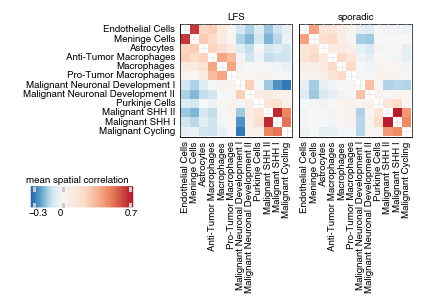

<ggplot: (8734185209697)>

In [28]:
from mizani.bounds import rescale

p = (
    ggplot(avgdf, aes("celltype1", "celltype2", fill="correlation"))
    + facet_wrap("type", ncol=2)
    + geom_tile()
    + scale_y_discrete(limits=avgdf.celltype2.cat.categories[::-1])
    + scale_fill_distiller(
        type="div",
        palette="RdBu",
        limits=(-0.3, 0.7),
        expand=(0, 0),
        breaks=(-0.3, 0, 0.7),
        values=rescale(np.hstack((np.linspace(-0.3, 0, 4), np.linspace(0, 0.7, 4)[1:]))),
    )
    + labs(x=None, y=None, fill="mean spatial correlation")
    + theme(
        aspect_ratio=1,
        figure_size=(3, 1.5),
        axis_text_x=element_text(rotation=90),
        axis_ticks=element_blank(),
        legend_direction="horizontal",
        legend_position=(-0.2, -0.3),
    )
)
p.save("figures/3C.svgz")
p

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 4 x 4 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/6A.svgz


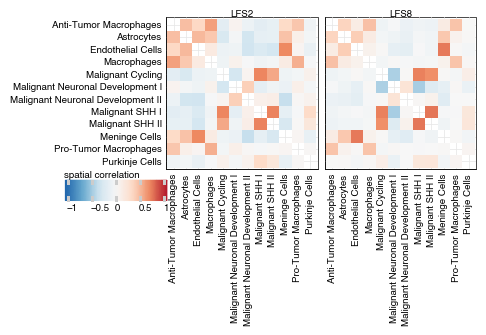

In [29]:
ctalphabeticalorder = df.celltype1.cat.categories.sort_values()
p = (
    ggplot(
        df[df["sample"].isin(("1.2", "3.4"))].assign(
            celltype1=lambda x: x.celltype1.cat.reorder_categories(ctalphabeticalorder),
            celltype2=lambda x: x.celltype2.cat.reorder_categories(ctalphabeticalorder),
        ),
        aes("celltype1", "celltype2", fill="correlation"),
    )
    + geom_tile()
    + scale_y_discrete(limits=ctalphabeticalorder[::-1])
    + facet_wrap("sample", labeller=human_sample_map)
    + scale_fill_distiller(type="div", palette="RdBu", limits=(-1, 1), expand=(0, 0))
    + labs(x=None, y=None, fill="spatial correlation")
    + theme(
        aspect_ratio=1,
        figure_size=(4, 4),
        axis_text_x=element_text(rotation=90),
        axis_ticks=element_blank(),
        legend_direction="horizontal",
        legend_position=(0, 0),
        legend_background=element_blank(),
    )
)
p.save("figures/6A.svgz")
print(p)

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 6 x 6 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S14.svgz


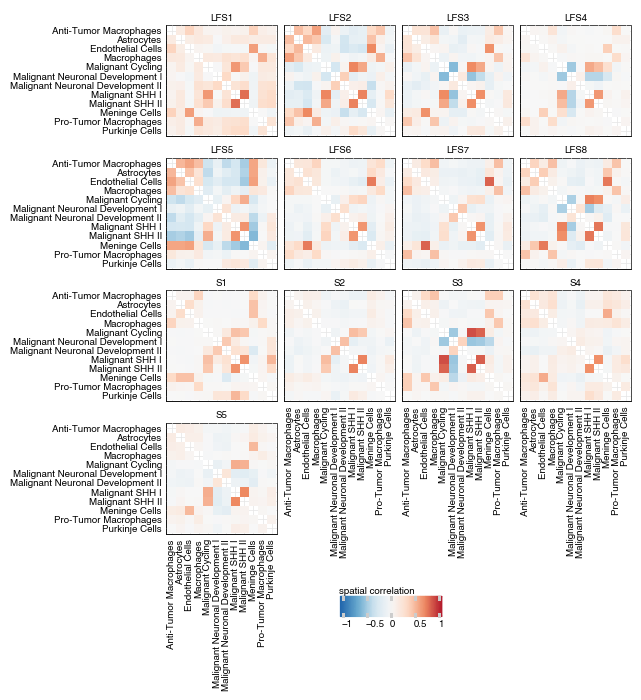

In [30]:
p = (
    ggplot(df.assign(
            celltype1=lambda x: x.celltype1.cat.reorder_categories(ctalphabeticalorder),
            celltype2=lambda x: x.celltype2.cat.reorder_categories(ctalphabeticalorder),
        ), aes("celltype1", "celltype2", fill="correlation"))
    + geom_tile()
    + scale_y_discrete(limits=ctalphabeticalorder[::-1])
    + facet_wrap("sample", labeller=human_sample_map)
    + scale_fill_distiller(type="div", palette="RdBu", limits=(-1, 1), expand=(0, 0))
    + labs(x=None, y=None, fill="spatial correlation")
    + theme(
        aspect_ratio=1,
        figure_size=(6, 6),
        axis_text_x=element_text(rotation=90),
        axis_ticks=element_blank(),
        legend_direction="horizontal",
        legend_position=(0.5, 0),
    )
)
p.save("figures/S14.svgz")
print(p)

In [31]:
malignant_celltypes = celltypeorder[7:]

In [32]:
samples = mod.sample_posterior(
    num_samples=5000,
    return_sites=["w_sf", "m_g", "s_g_gene_add", "detection_y_s"],
    use_gpu=True,
    batch_size=adata_vis.n_obs,
    return_samples=True,
)

Sampling global variables, sample: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4999/4999 [02:35<00:00, 32.22it/s]


In [33]:
obs2sample = pd.get_dummies(
    mod.adata_manager.get_from_registry("batch").squeeze()
).to_numpy()

In [34]:
nes_predicted = (
    samples["posterior_samples"]["m_g"][
        ..., mod.cell_state_df_.index == "NES"
    ].squeeze()[:, np.newaxis]
    * (
        samples["posterior_samples"]["w_sf"][
            ..., np.isin(mod.factor_names_, malignant_celltypes)
        ]
        @ mod.cell_state_df_.loc["NES", malignant_celltypes].to_numpy()[:, np.newaxis]
    ).squeeze()
)

In [35]:
adata_vis.obs["NES_mean_malignant_posterior_expression"] = nes_predicted.mean(axis=0)
adata_vis.obs[
    ["NES_q05_malignant_posterior_expression", "NES_q95_malignant_posterior_expression"]
] = np.quantile(nes_predicted, [0.05, 0.95], axis=0).T

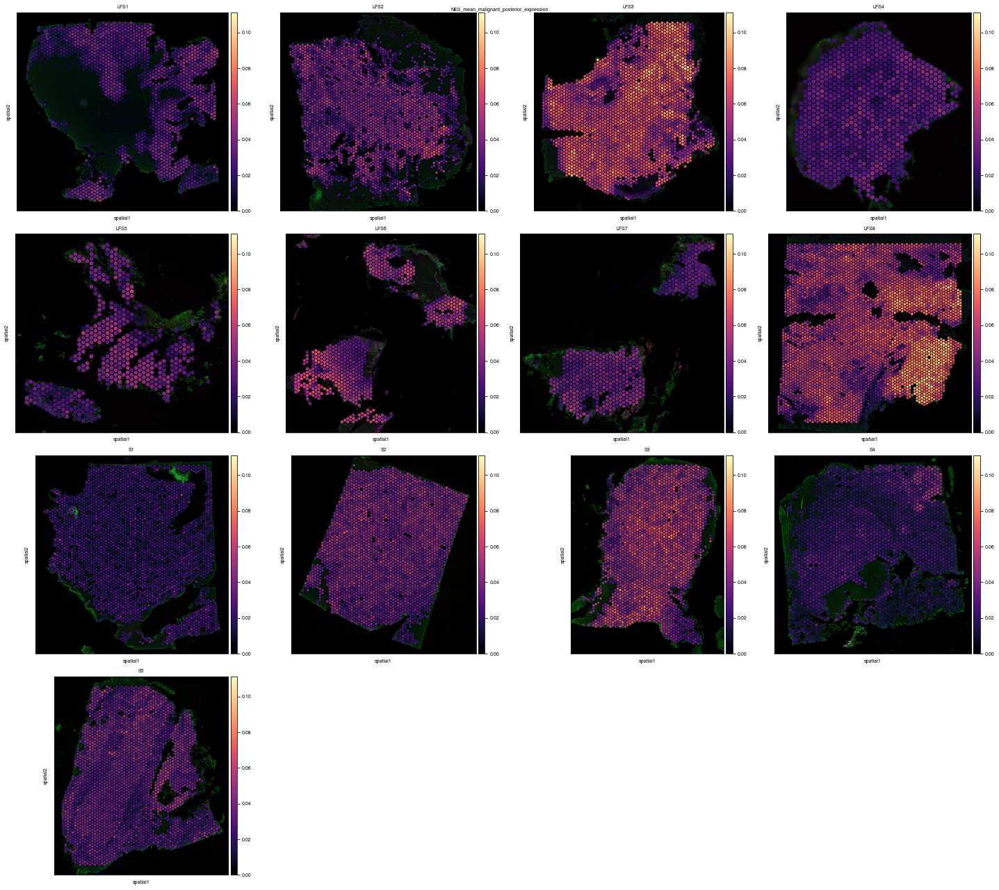

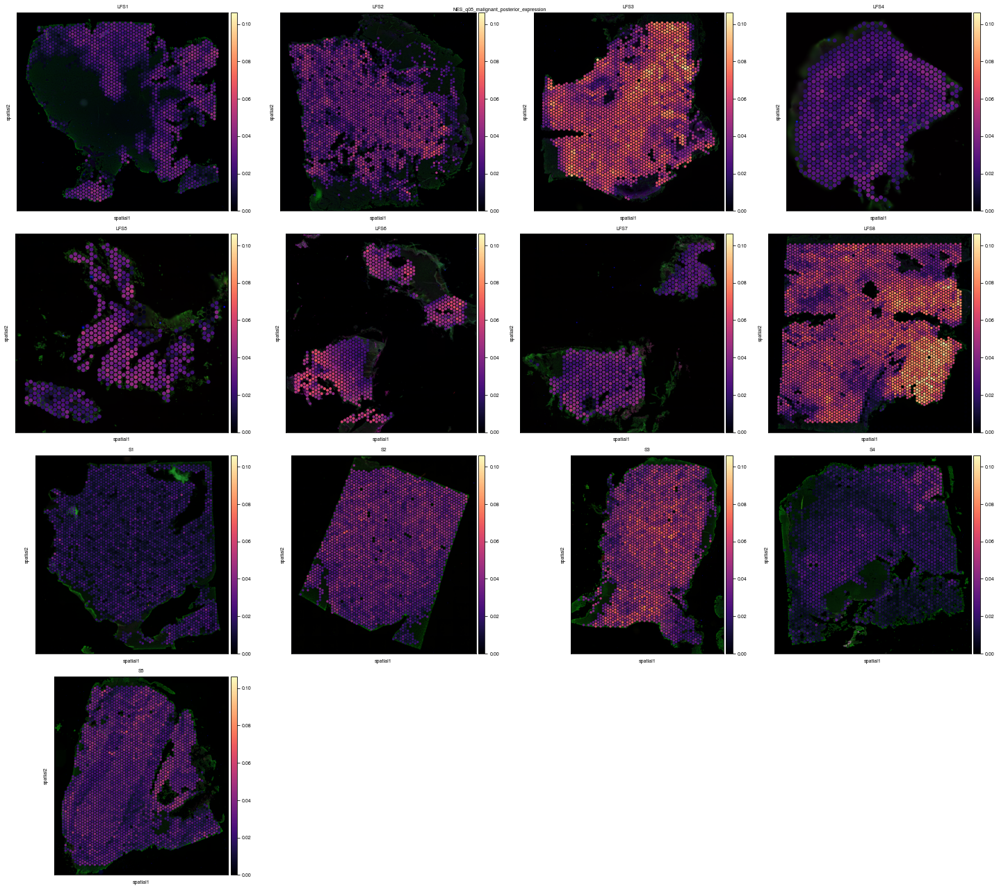

In [36]:
for celltype in ("NES_mean_malignant_posterior_expression", "NES_q05_malignant_posterior_expression"):
    fig = plt.figure(figsize=(20, 18), layout="tight")
    ncols = 4
    nrows = int(np.ceil(len(adata_vis.uns["spatial"]) / ncols))
    vmax = adata_vis.obs[celltype].max()
    for i, sample in enumerate(sorted(adata_vis.uns["spatial"].keys())):
        slide = select_slide(adata_vis, sample)
        ax = fig.add_subplot(nrows, ncols, i + 1)
        sc.pl.spatial(
            slide,
            cmap="magma",
            color=celltype,
            ncols=5,
            size=1.3,
            vmin=0,
            vmax=vmax,
            show=False,
            ax=ax,
            title=human_sample_map[sample],
        )
    fig.suptitle(celltype)

In [37]:
obs2sample = pd.get_dummies(
    mod.adata_manager.get_from_registry("batch").squeeze()
).to_numpy()
nes_predicted_all = (
    samples["posterior_samples"]["m_g"][
        ..., mod.cell_state_df_.index == "NES"
    ].squeeze()[:, np.newaxis]
    * (
        samples["posterior_samples"]["w_sf"]
        @ mod.cell_state_df_.loc["NES", :].to_numpy()[:, np.newaxis]
    ).squeeze()
    + (
        obs2sample
        @ samples["posterior_samples"]["s_g_gene_add"][
            ..., mod.cell_state_df_.index == "NES"
        ]
    ).squeeze()
)

In [38]:
frac = nes_predicted / nes_predicted_all
adata_vis.obs["NES_mean_malignant_posterior_expression_frac"] = adata_vis[
    :, "NES"
].X.toarray().squeeze() * frac.mean(axis=0)
adata_vis.obs[
    [
        "NES_q05_malignant_posterior_expression_frac",
        "NES_q95_malignant_posterior_expression_frac",
    ]
] = (
    adata_vis[:, "NES"].X.toarray() * np.quantile(frac, [0.05, 0.95], axis=0).T
)

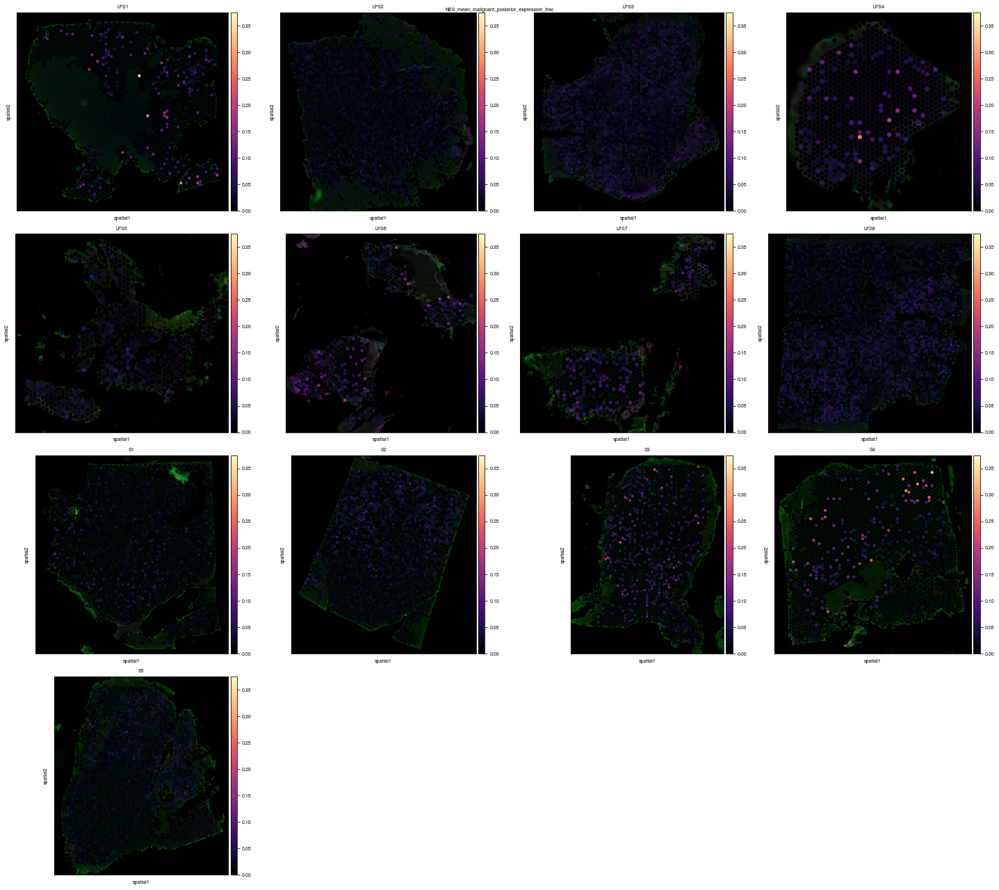

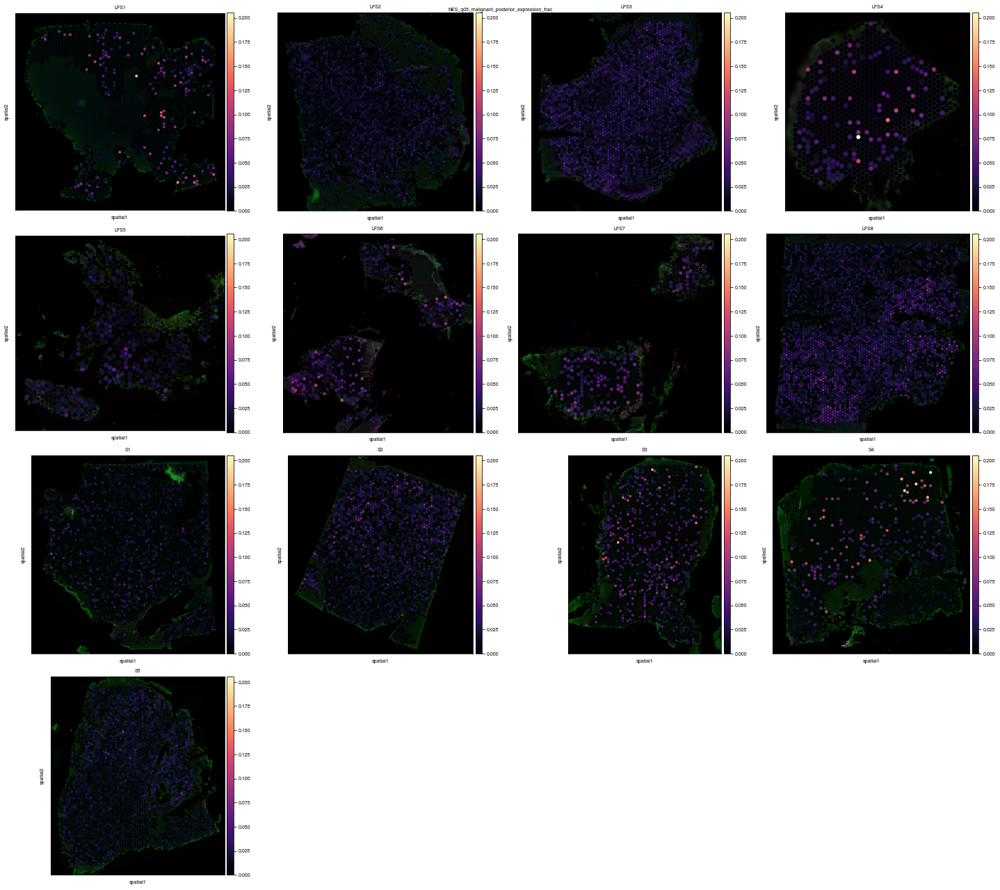

In [39]:
for celltype in ("NES_mean_malignant_posterior_expression_frac", "NES_q05_malignant_posterior_expression_frac"):
    fig = plt.figure(figsize=(20, 18), layout="tight")
    ncols = 4
    nrows = int(np.ceil(len(adata_vis.uns["spatial"]) / ncols))
    vmax = adata_vis.obs[celltype].max()
    for i, sample in enumerate(sorted(adata_vis.uns["spatial"].keys())):
        slide = select_slide(adata_vis, sample)
        ax = fig.add_subplot(nrows, ncols, i + 1)
        sc.pl.spatial(
            slide,
            cmap="magma",
            color=celltype,
            ncols=5,
            size=1.3,
            vmin=0,
            vmax=vmax,
            show=False,
            ax=ax,
            title=human_sample_map[sample],
        )
    fig.suptitle(celltype)

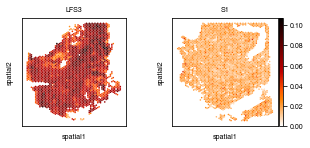

In [40]:
with mpl.rc_context({"figure.figsize": (5, 2)}):
    slides = select_slide(adata_vis, "1.3"), select_slide(adata_vis, "4.1")
    fig, ax = plt.subplots(1, 2)
    vmax = np.max([slide.obs["NES_mean_malignant_posterior_expression"].max() for slide in slides])
    for i, (title, slide) in enumerate(zip(("1.3", "4.1"), slides)):
        cbarloc = "right" if i == len(slides) - 1 else None
        sc.pl.spatial(
            slide,
            cmap=mpl.cm.get_cmap("gist_heat").reversed(),
            img_key=None,
            size=1.5,
            color="NES_mean_malignant_posterior_expression",
            vmin=0,
            vmax=vmax,
            ax=ax[i],
            colorbar_loc=cbarloc,
            title=human_sample_map[title],
            show=False
        )
    
    fig.savefig("figures/8F_malignant.svgz")
    plt.show()

/tmp/ipykernel_45602/3510636840.py:34: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.


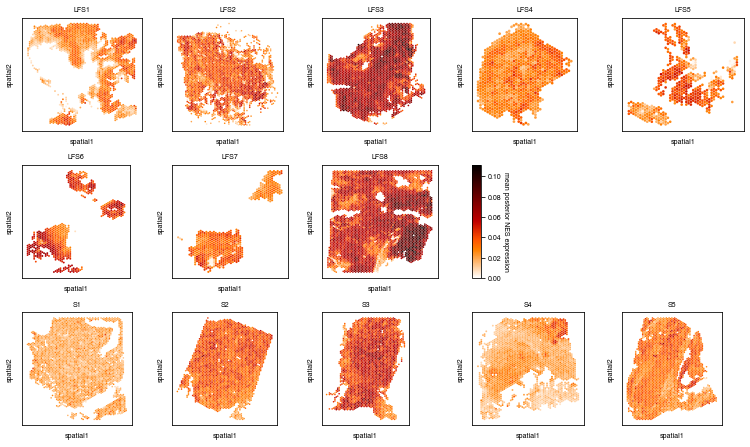

In [41]:
fig, axs = plt.subplots(3, 5)
fig.set_size_inches(13, 7.5)
fig.delaxes(axs[1, 4])

vmax = adata_vis.obs.NES_mean_malignant_posterior_expression.max().max()
for i, sname in enumerate(sorted(adata_vis.uns["spatial"].keys())):
    row = 0 if i < 5 else 1 if i < 8 else 2
    col = (i - row * 5) % 5 if i < 8 else (i - 8) % 5

    slide = select_slide(adata_vis, sname)
    sc.pl.spatial(
        slide,
        title=human_sample_map[sname],
        cmap=mpl.cm.get_cmap("gist_heat").reversed(),
        color="NES_mean_malignant_posterior_expression",
        img_key=None,
        size=1.5,
        ax=axs[row, col],
        show=False,
        colorbar_loc=None,
        vmin=0,
        vmax=vmax,
    )
    axs[row, col].set_anchor("NW")

cbar = fig.colorbar(axs[0, 0].collections[0], axs[1, 3])
cbar.set_label(f"mean posterior NES expression", rotation=-90, labelpad=8)

fig.subplots_adjust(hspace=0.3)
box = axs[1, 3].get_position()
axs[1, 3].set_position([box.x0, box.y0, box.width * 0.07, box.height])

fig.savefig("figures/S23.svgz")
fig.show()

/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:718: PlotnineWarning: Saving 3 x 1.95 in image.
/home/kats/.local/lib/python3.10/site-packages/plotnine/ggplot.py:719: PlotnineWarning: Filename: figures/S23_violin.svgz
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/li

/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:694: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
/home/kats/.local/lib/python3.10/site-packages/plotnine/utils.py:693: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[

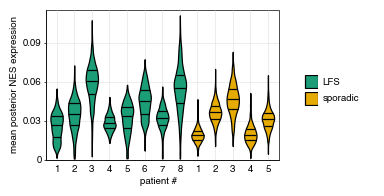

In [43]:
df = adata_vis.obs.assign(
    type=lambda x: np.where(x["sample"].str[0].astype(int) <= 3, "LFS", "sporadic"),
    sample=lambda x: x["sample"].astype(str).replace(human_sample_map),
)
p = (
    ggplot(df, aes("sample", "NES_mean_malignant_posterior_expression", fill="type"))
    + geom_violin(
        scale="width",
        color="black",
        n=4096,
        width=0.7,
        position=position_dodge(width=0.9),
        draw_quantiles=[0.25, 0.5, 0.75],
    )
    + scale_x_discrete(labels=lambda x: [k[-1] for k in x.keys()])
    + scale_y_continuous(limits=(0, None), expand=(0, 0, 0.04, 0))
    + lfs_sporadic_fill_scale
    + labs(x="patient #", y="mean posterior NES expression", color="", fill="")
    + theme(
        aspect_ratio="auto",
        figure_size=(3, 1.95),
        axis_ticks_major_x=element_blank(),
    )
)
p.save("figures/S23_violin.svgz")
print(p)

In [45]:
aggdf = (
    df.groupby(["sample", "type"], observed=True)["NES_mean_malignant_posterior_expression"]
    .agg(np.median)
    .reset_index(level=0)
)
mannwhitneyu(
    aggdf.loc["LFS", "NES_mean_malignant_posterior_expression"],
    aggdf.loc["sporadic", "NES_mean_malignant_posterior_expression"],
)

MannwhitneyuResult(statistic=27.0, pvalue=0.3543123543123543)